In [2]:
from osgeo import gdal
import matplotlib.pyplot as plt
import rasterio
import numpy as np
import rioxarray

In [3]:
rds = rioxarray.open_rasterio('test1.tif')
rds_4326 = rds.rio.reproject("EPSG:4326")
rds_4326.rio.to_raster("test1_repr.tif")

In [4]:
rds = rioxarray.open_rasterio('test2.tif')
rds_4326 = rds.rio.reproject("EPSG:4326")
rds_4326.rio.to_raster("test2_repr.tif")

In [5]:
dataset1 = gdal.Open('test1_repr.tif')
dataset2 = gdal.Open('test2_repr.tif')

In [6]:
def create_pixel_array(dataset):
    band1 = dataset.GetRasterBand(1) # Red channel
    band2 = dataset.GetRasterBand(2) # Green channel
    band3 = dataset.GetRasterBand(3) # Blue channel

    b1 = band1.ReadAsArray()
    b2 = band2.ReadAsArray()
    b3 = band3.ReadAsArray()

    img = np.dstack((b1, b2, b3))
    return img

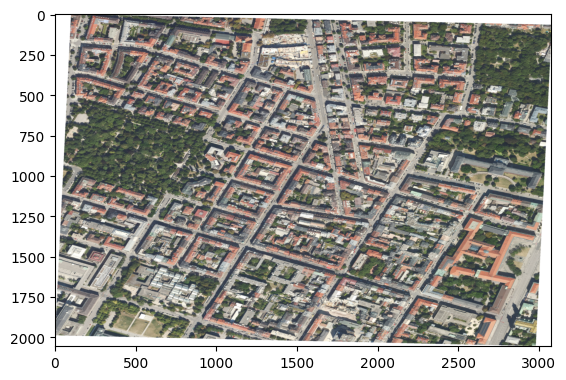

In [7]:
img1 = create_pixel_array(dataset1)
plt.imshow(img1)
plt.show()

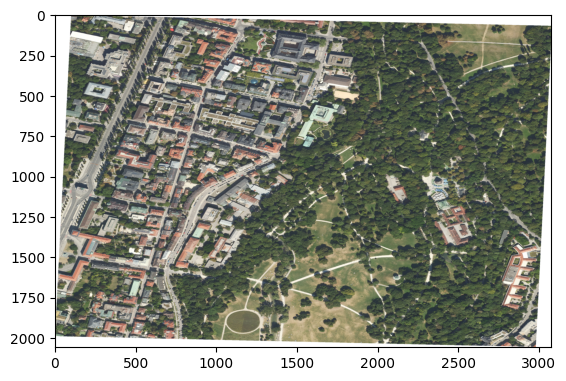

In [8]:
img2 = create_pixel_array(dataset2)
plt.imshow(img2)
plt.show()

In [9]:
from osgeo import gdal
raster_path = 'test1.tif'
info = gdal.Info(raster_path, format='json')
polygon = info['wgs84Extent']

In [11]:
import folium
center = polygon['coordinates'][0][0][::-1]
m = folium.Map(location=center, zoom_start=15)

def add_image_to_map(path, img):
    info = gdal.Info(path, format='json')
    polygon = info['wgs84Extent']

    #folium.GeoJson(polygon).add_to(m)

    bounds = [
        [polygon['coordinates'][0][0][1], polygon['coordinates'][0][0][0]],
        [polygon['coordinates'][0][1][1], polygon['coordinates'][0][1][0]],
        [polygon['coordinates'][0][2][1], polygon['coordinates'][0][2][0]],
        [polygon['coordinates'][0][3][1], polygon['coordinates'][0][3][0]],
    ]

    # Create the image overlay and add it to the map
    folium.raster_layers.ImageOverlay(
        img,
        bounds=bounds,
        opacity=0.95,
        interactive=True,
        cross_origin=False,
        zindex=1,
    ).add_to(m)


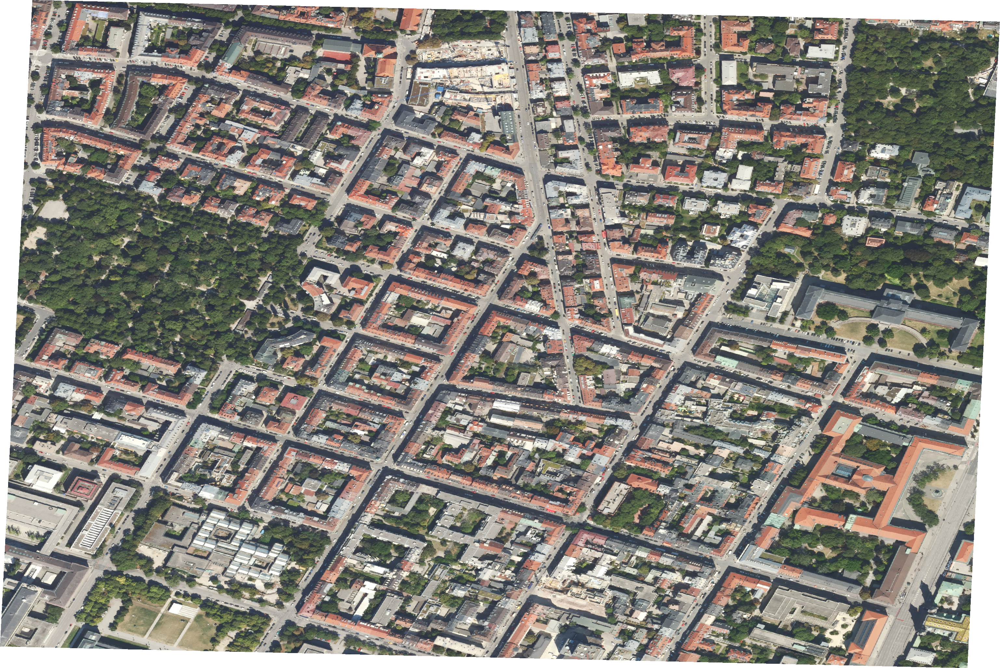
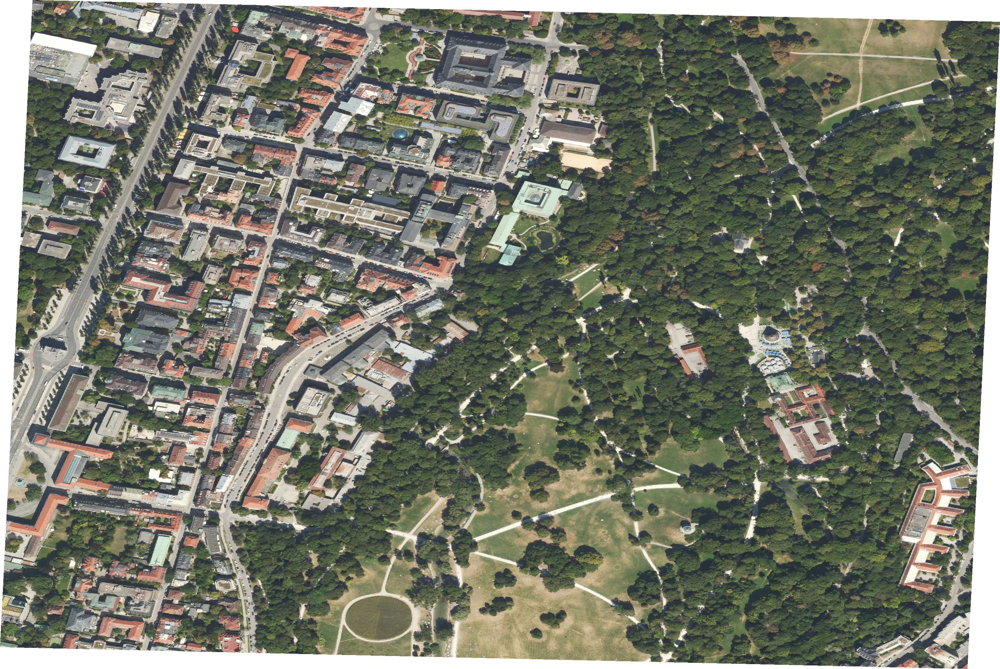

In [12]:
add_image_to_map('test1.tif', img1)
add_image_to_map('test2.tif', img2)
m